In [28]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters.rank import entropy
from skimage.morphology import disk
from skimage.color import rgb2gray
import warnings
import random
warnings.filterwarnings("ignore")

### Data preprocessing: Entropy Filtering

In [12]:
# Function to apply entropy filtering with a given disk radius
def apply_entropy_filtering(image, radius):
    gray_image = rgb2gray(image)  # Convert to grayscale
    entropy_image = entropy(gray_image, disk(radius))  # Compute entropy with specified radius
    return entropy_image

#### Hyper parameter tuning for Entropy Filtering

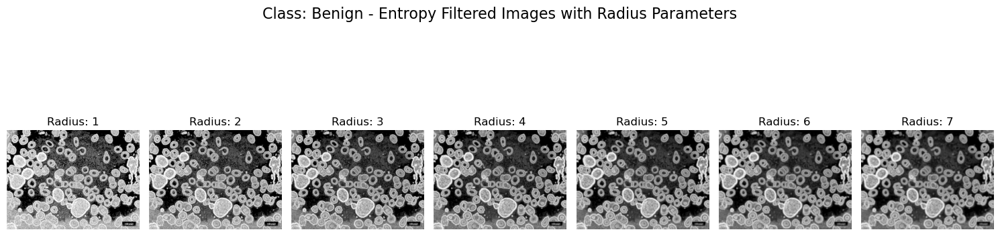

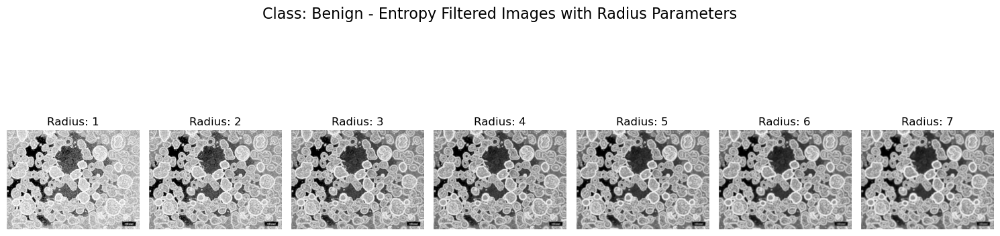

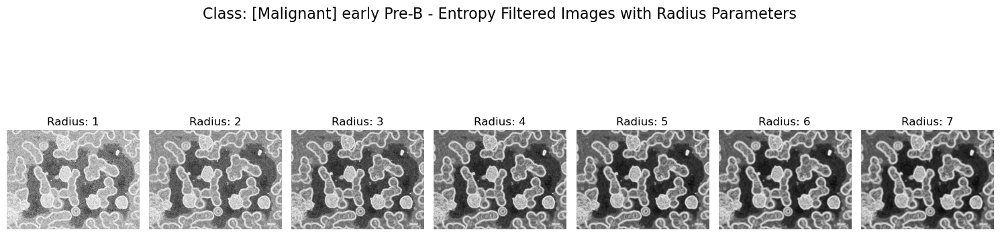

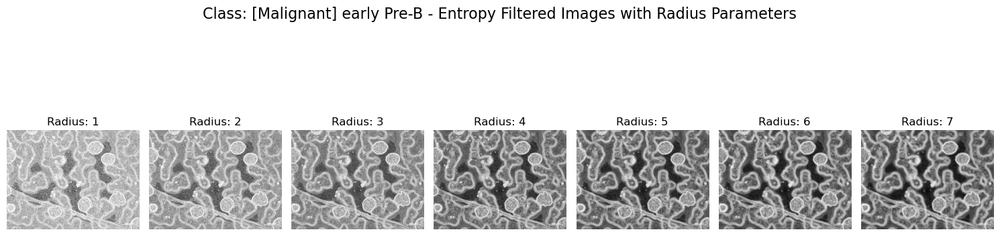

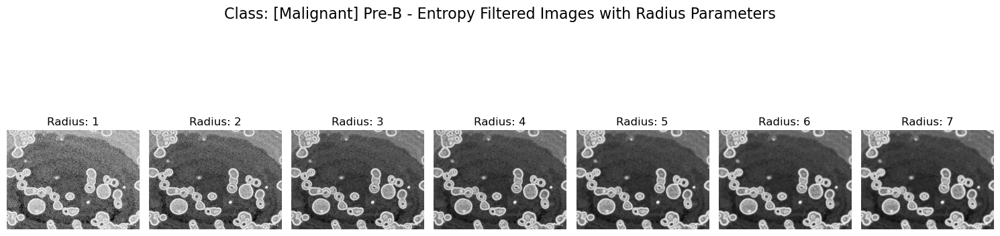

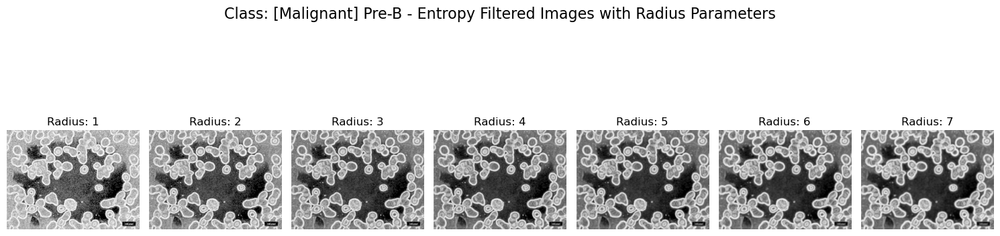

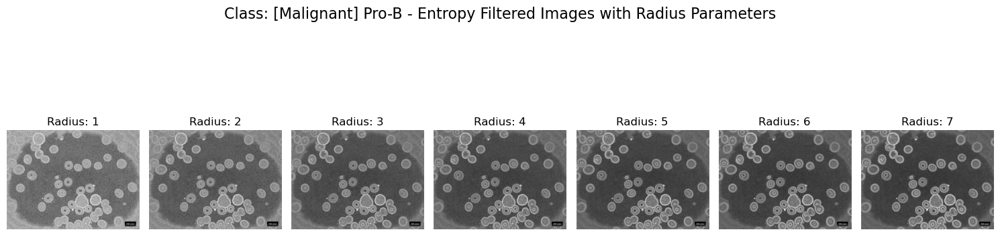

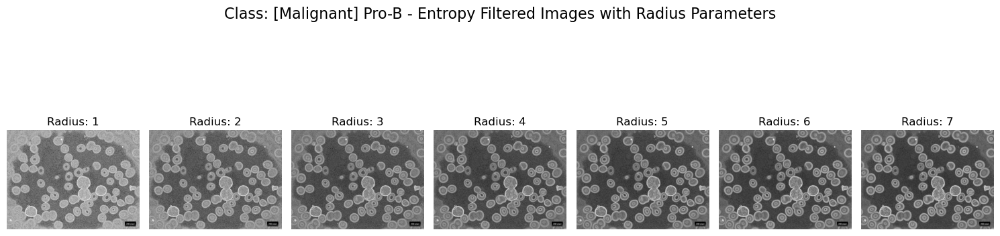

In [25]:
# Define the dataset path
dataset_path = r'.\Blood cell Cancer [ALL]'

# Get the class folders
classes = [folder for folder in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, folder))]


# Radii for hyperparameter tuning
radii = [1,2,3,4, 5,6,7]

#  visualization to display only preprocessed images
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    images = [os.path.join(class_path, img) for img in os.listdir(class_path) if img.endswith(('png', 'jpg', 'jpeg'))]
    
    # Select 2 images from each class for hyperparameter tuning visualization
    selected_images = images[:2]
    
    for img_path in selected_images:
        # Read the image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        fig, axes = plt.subplots(1, len(radii), figsize=(15, 5))
        fig.suptitle(f'Class: {cls} - Entropy Filtered Images with Radius Parameters', fontsize=16)
        
        # Plot entropy filtered images for each radius
        for j, radius in enumerate(radii):
            filtered_image = apply_entropy_filtering(image, radius)
            axes[j].imshow(filtered_image, cmap='gray')
            axes[j].set_title(f'Radius: {radius}')
            axes[j].axis('off')
        
        plt.tight_layout()
        plt.show()



### Displaying image with the selected parameter

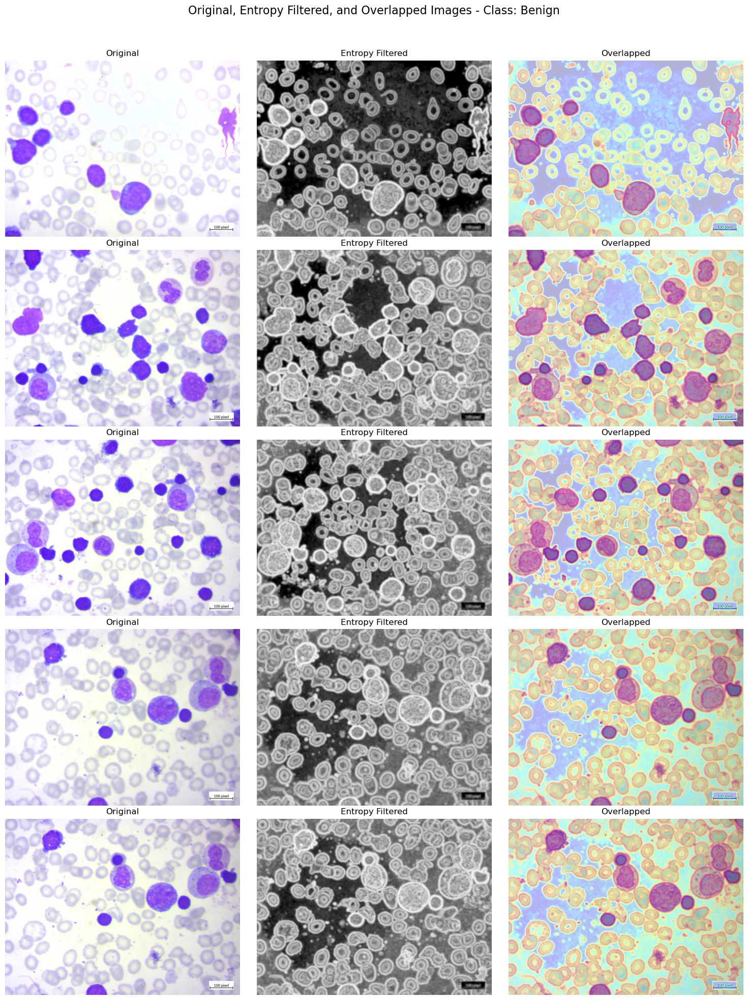

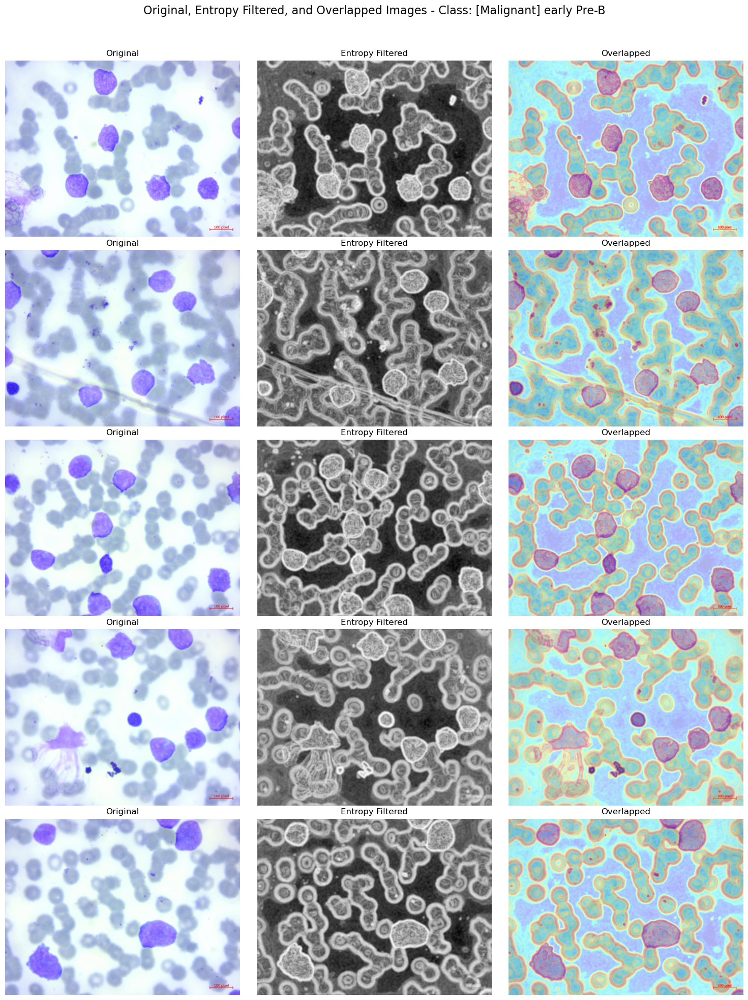

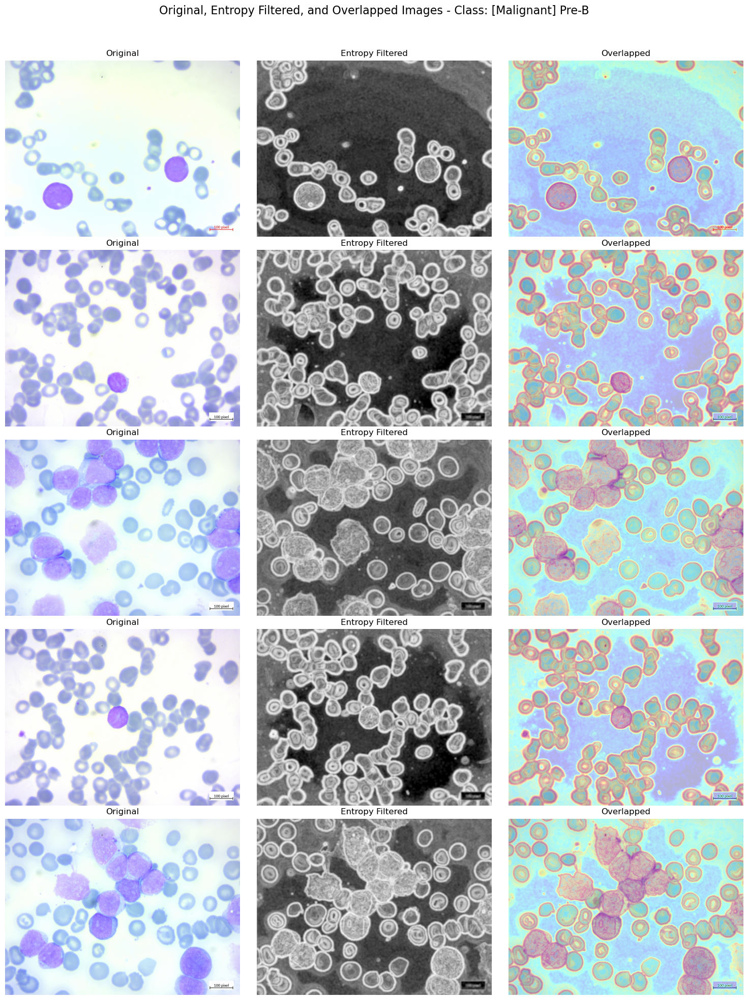

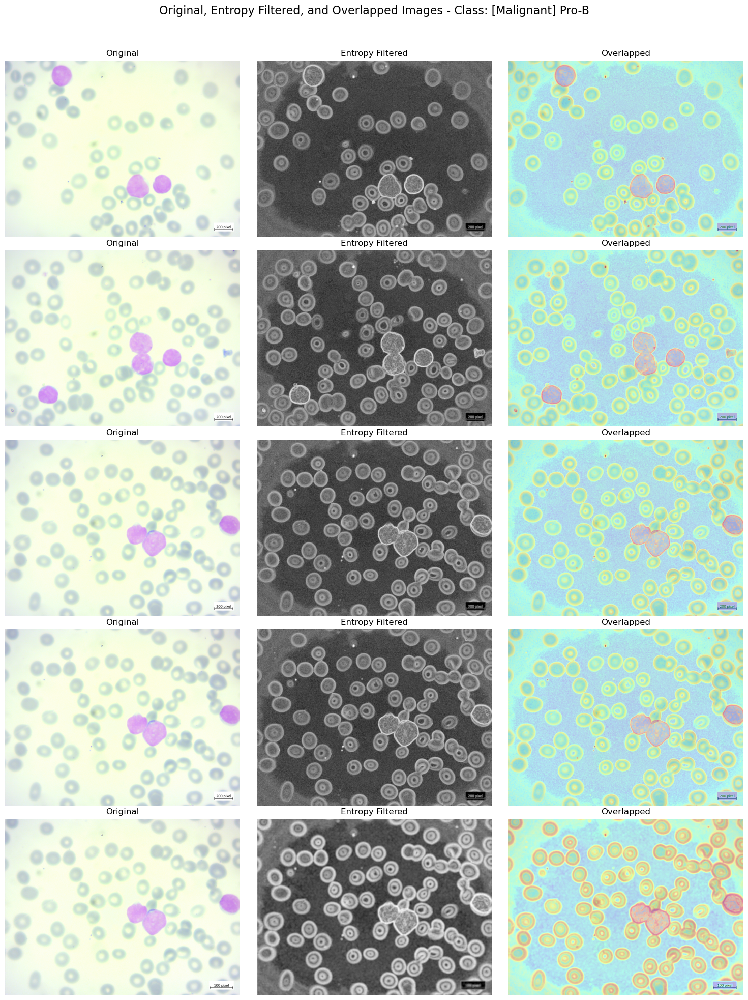

In [23]:
# visualization to overlapping of images
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    images = [os.path.join(class_path, img) for img in os.listdir(class_path) if img.endswith(('png', 'jpg', 'jpeg'))]
    
    # Select 5 images from each class
    selected_images = images[:5]
    
    fig, axes = plt.subplots(5, 3, figsize=(15, 20))
    fig.suptitle(f'Original, Entropy Filtered, and Overlapped Images - Class: {cls}', fontsize=16)
    
    for i, img_path in enumerate(selected_images):
        # Read and preprocess the image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        filtered_image = apply_entropy_filtering(image, 5)
        
        # Normalize filtered image for blending
        filtered_image_normalized = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
        filtered_colored = cv2.applyColorMap(filtered_image_normalized, cv2.COLORMAP_JET)  # Apply color map
        filtered_colored = cv2.cvtColor(filtered_colored, cv2.COLOR_BGR2RGB)  # Convert to RGB for blending
        
        # Blend the original image with the colored entropy-filtered image
        overlapped_image = cv2.addWeighted(image, 0.7, filtered_colored, 0.3, 0)
        
        # Plot original image
        axes[i, 0].imshow(image)
        axes[i, 0].set_title('Original')
        axes[i, 0].axis('off')
        
        # Plot entropy filtered image
        axes[i, 1].imshow(filtered_image,  cmap='gray')
        axes[i, 1].set_title('Entropy Filtered')
        axes[i, 1].axis('off')
        
        # Plot overlapped image
        axes[i, 2].imshow(overlapped_image)
        axes[i, 2].set_title('Overlapped')
        axes[i, 2].axis('off')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


### Data preprocessing: Region Growing Segmentation

In [46]:
# Function to apply Region Growing Segmentation
def apply_region_growing(image, seed_point, tolerance):
    gray_image = rgb2gray(image)  # Convert to grayscale
    mask = flood(gray_image, seed_point, tolerance=tolerance)  # Apply region growing
    segmented_image = mask * gray_image  # Mask the original image
    return segmented_image

seed_point = (10, 10) 

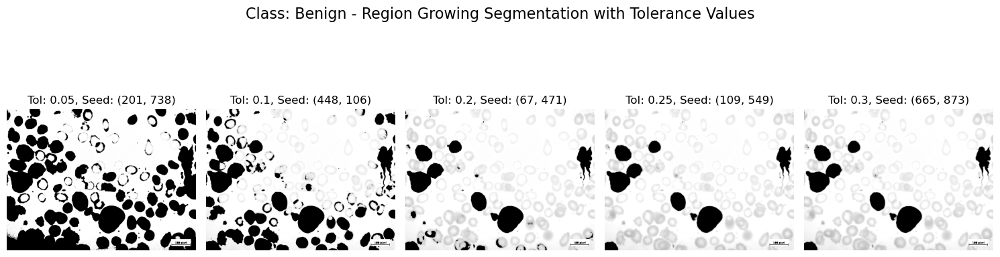

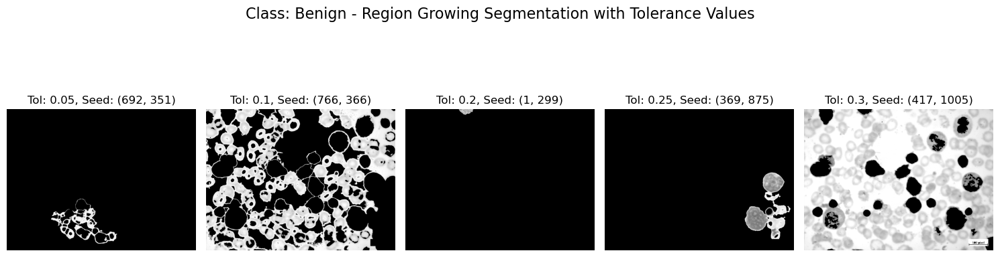

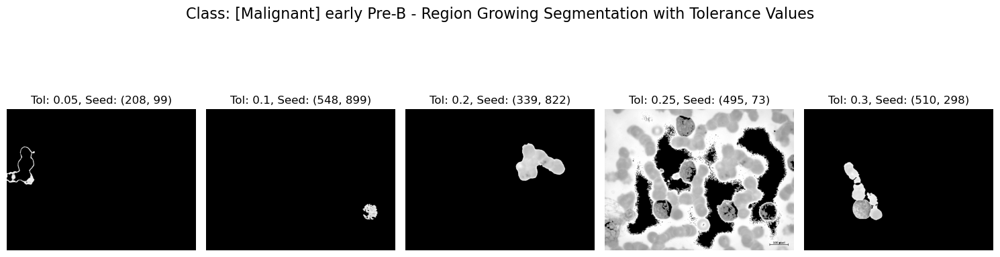

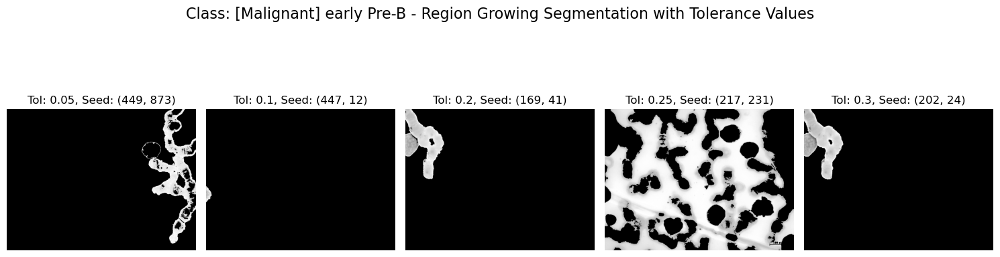

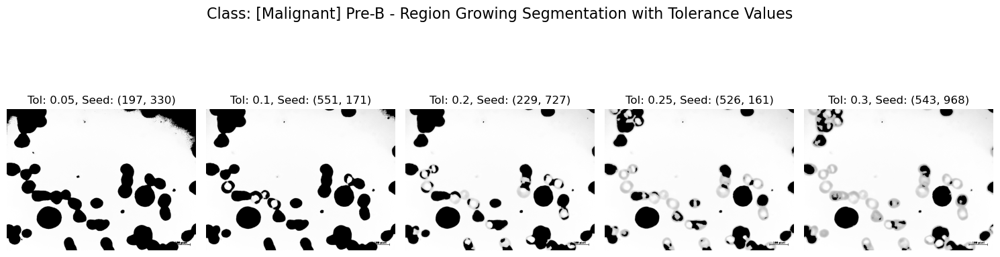

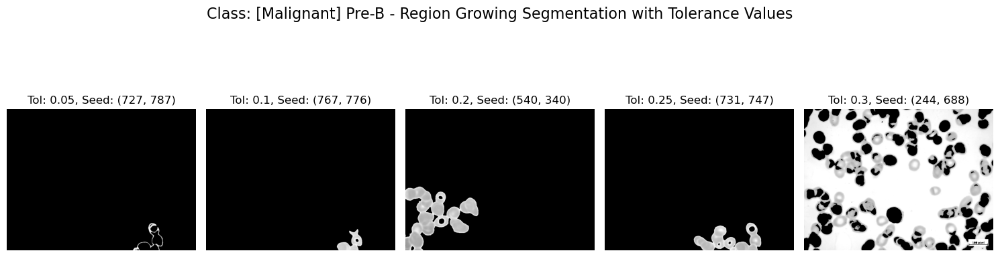

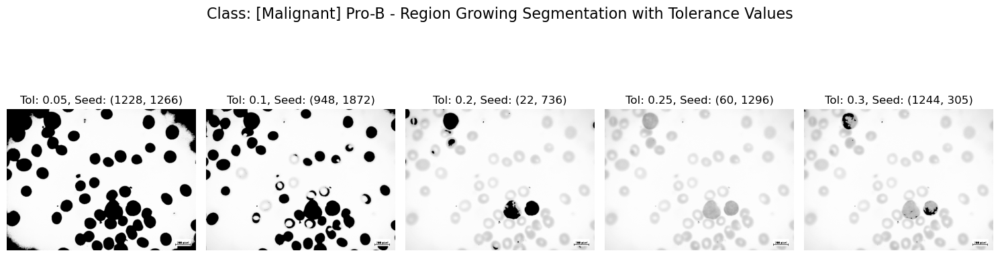

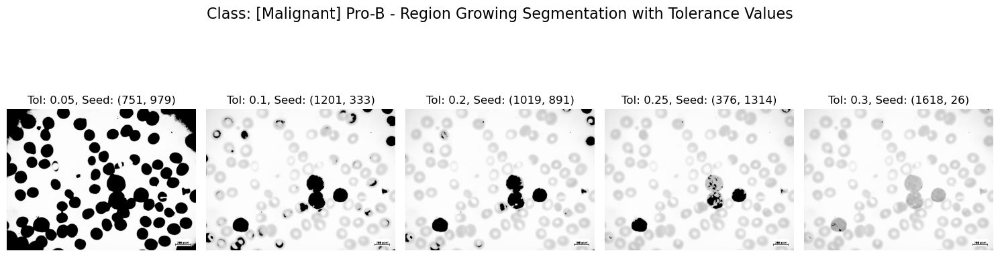

In [47]:
# tolerance values for hyperparameter tuning
tolerance_values = [0.05, 0.1, 0.2,0.25,.3]

# Function to dynamically select seed points
def get_seed_point(image):
    height, width = image.shape[:2]
    return random.randint(0, height - 1), random.randint(0, width - 1)

# Hyperparameter tuning visualization for Region Growing Segmentation
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    images = [os.path.join(class_path, img) for img in os.listdir(class_path) if img.endswith(('png', 'jpg', 'jpeg'))]
    
    # Select 2 images from each class for hyperparameter tuning visualization
    selected_images = images[:2]
    
    for img_path in selected_images:
        # Read the image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        fig, axes = plt.subplots(1, len(tolerance_values), figsize=(15, 5))
        fig.suptitle(f'Class: {cls} - Region Growing Segmentation with Tolerance Values', fontsize=16)
        
        # Apply Region Growing Segmentation for different tolerance values
        for j, tol in enumerate(tolerance_values):
            # Dynamically choose a seed point for each image
            seed_point = get_seed_point(image)
            segmented_image = apply_region_growing(image, seed_point, tol)
            
            # Plot segmented image
            axes[j].imshow(segmented_image, cmap='gray')
            axes[j].set_title(f'Tol: {tol}, Seed: {seed_point}')
            axes[j].axis('off')
        
        plt.tight_layout()
        plt.show()


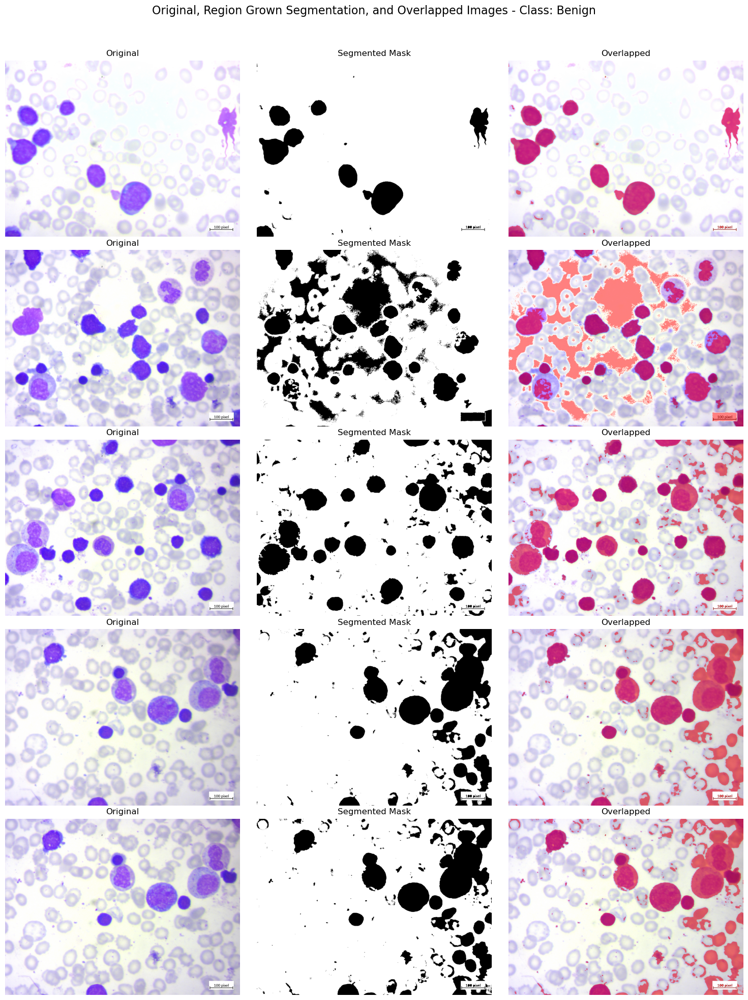

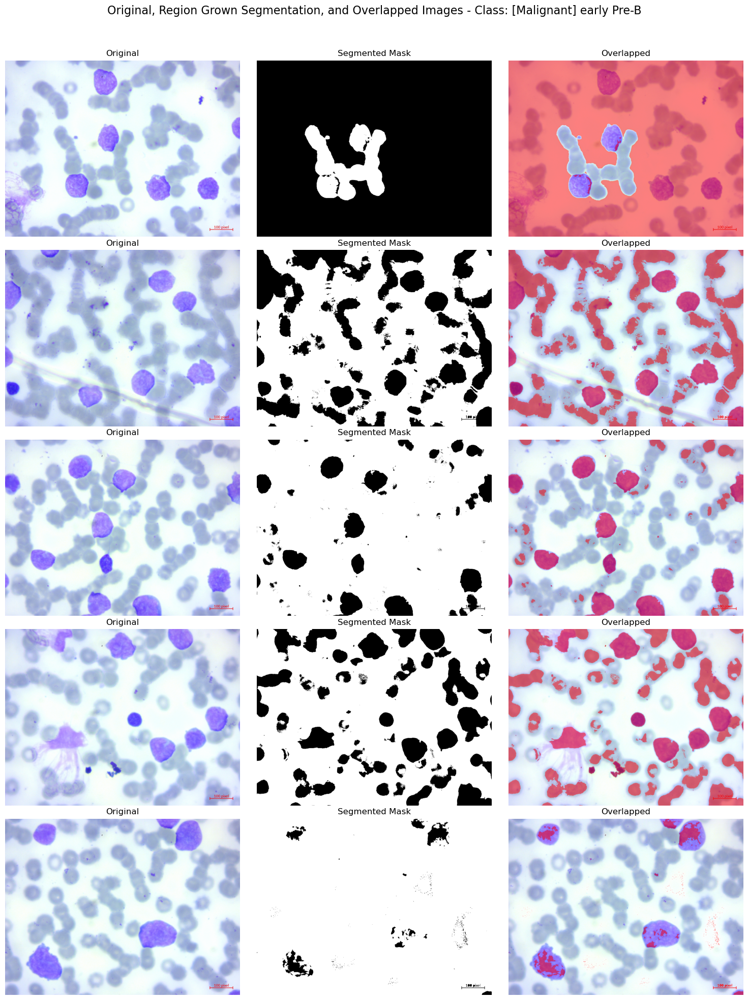

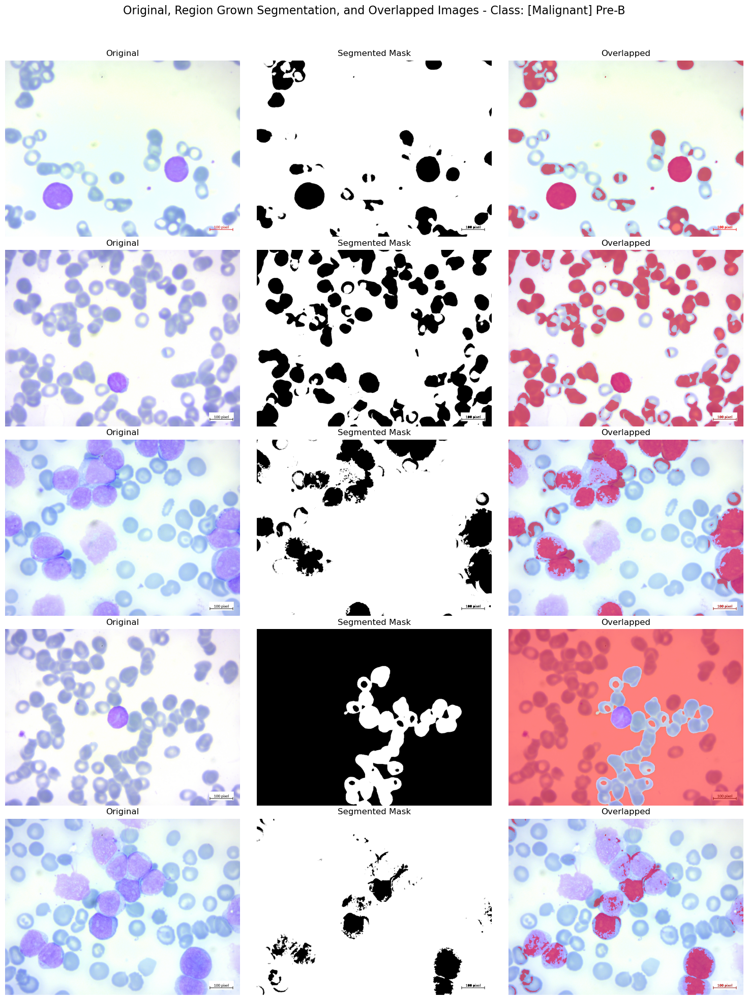

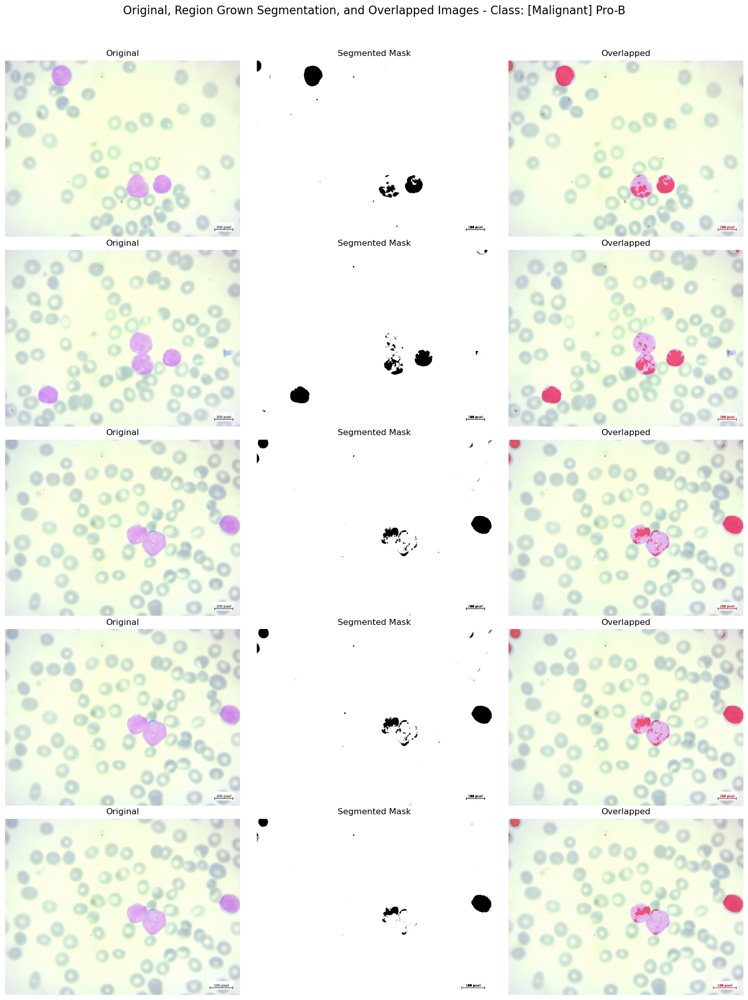

In [55]:
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    images = [os.path.join(class_path, img) for img in os.listdir(class_path) if img.endswith(('png', 'jpg', 'jpeg'))]
    
    # Select 5 images from each class
    selected_images = images[:5]
    
    fig, axes = plt.subplots(5, 3, figsize=(15, 20))
    fig.suptitle(f'Original, Region Grown Segmentation, and Overlapped Images - Class: {cls}', fontsize=16)
    
    for i, img_path in enumerate(selected_images):
        # Read and preprocess the image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Dynamically calculate a valid seed point
        height, width = image.shape[:2]
        seed_point = (height // 2, width // 2)  # Use the center of the image as the seed point
        
        # Apply Region Growing Segmentation
        mask = apply_region_growing(image, seed_point, tolerance=0.25).astype(bool)
        
        # Create a transparent overlay for non-segmented regions
        overlay = image.copy()
        overlay[~mask] = [255, 0, 0]  # Highlight non-segmented regions in red
        
        # Blend the overlay with the original image
        alpha = 0.5  # Transparency factor
        blended_image = cv2.addWeighted(image, 1 - alpha, overlay, alpha, 0)
        
        # Plot original image
        axes[i, 0].imshow(image)
        axes[i, 0].set_title('Original')
        axes[i, 0].axis('off')
        
        # Plot region grown segmented image
        axes[i, 1].imshow(mask, cmap='gray')
        axes[i, 1].set_title('Segmented Mask')
        axes[i, 1].axis('off')
        
        # Plot overlapped image
        axes[i, 2].imshow(blended_image)
        axes[i, 2].set_title('Overlapped')
        axes[i, 2].axis('off')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
